Tutorial:
https://colab.research.google.com/github/google/eng-edu/blob/master/ml/pc/exercises/image_classification_part1.ipynb#scrollTo=YHK6DyunSbs4

In [ ]:
import tensorflow
print(tensorflow.__version__)
import tensorflow as tf
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
import os
import zipfile
import numpy as np
from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import RMSprop
import shutil
from google.colab import drive
import PIL.Image as Image
import signal
import urllib.request
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

2.4.0


In [ ]:
!pip install PyDrive

Delete train and validation folder if you need to do

In [ ]:
shutil.rmtree('/tmp/train')
shutil.rmtree('/tmp/validation')

FileNotFoundError: ignored

Download sample zip from Google Drive

　　　　　　　Baby　　　　　Person

Train 　　　| 　260　　　　　　300

Validation　| 　130　　　　　　150

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
 
downloaded = drive.CreateFile({'id':"1n2xEwGXHNOxsQHdn4LvktUfCAp3pE-nv"})   # replace the id with id of file you want to access
downloaded.GetContentFile('/tmp/man.zip')        # replace the file name with your file

Extract zip

In [ ]:
local_zip = '/tmp/man.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/tmp')
zip_ref.close()

Join directories for babies and people

In [ ]:
base_dir = '/tmp/manfolder'
train_dir = os.path.join(base_dir, 'train')
validation_dir = os.path.join(base_dir, 'validation')
 
train_baby_dir = os.path.join(train_dir, 'baby')
train_person_dir = os.path.join(train_dir, 'person')
validation_baby_dir = os.path.join(validation_dir, 'baby')
validation_person_dir = os.path.join(validation_dir, 'person')

Check the total number of images

In [ ]:
print('total training baby images:', len(os.listdir(train_baby_dir)))
print('total training person images:', len(os.listdir(train_person_dir)))
print('total validation baby images:', len(os.listdir(validation_baby_dir)))
print('total validation person images:', len(os.listdir(validation_person_dir)))

total training baby images: 260
total training person images: 300
total validation baby images: 130
total validation person images: 150


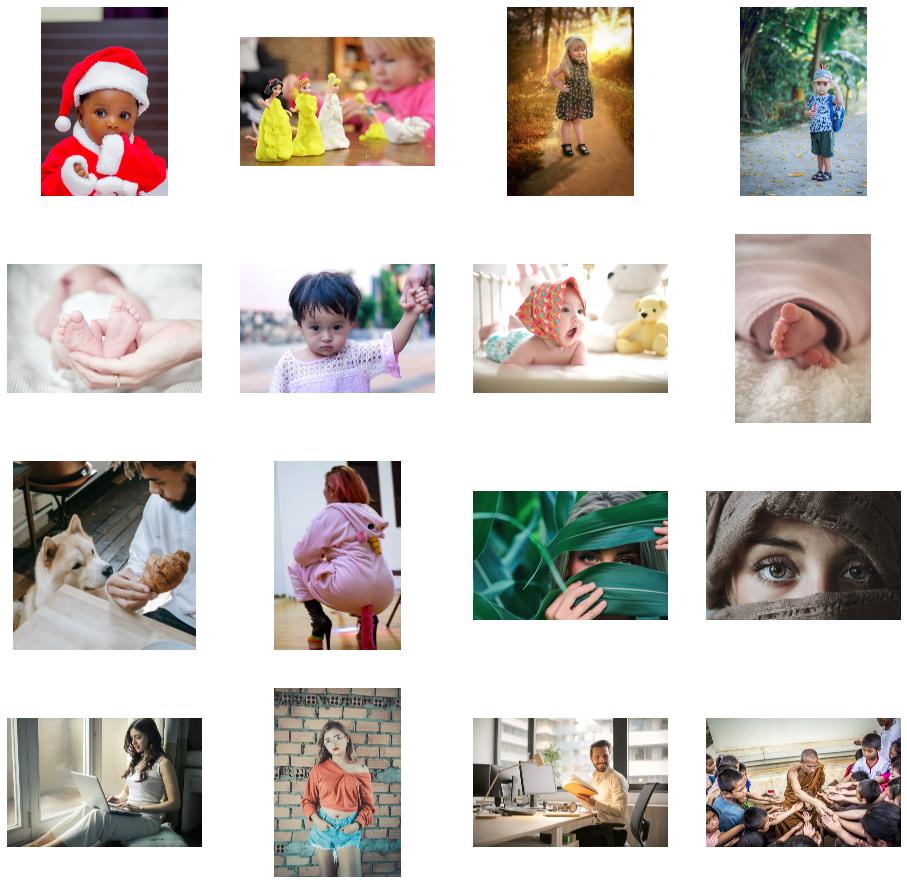

In [ ]:
train_baby_fnames = os.listdir(train_baby_dir)
train_person_fnames = os.listdir(train_person_dir)
train_person_fnames.sort()

%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Parameters for our graph; we'll output images in a 4x4 configuration
nrows = 4
ncols = 4

# Index for iterating over images
pic_index = 0

# Set up matplotlib fig, and size it to fit 4x4 pics
fig = plt.gcf()
fig.set_size_inches(ncols * 4, nrows * 4)

pic_index += 8
next_baby_pix = [os.path.join(train_baby_dir, fname) 
                for fname in train_baby_fnames[pic_index-8:pic_index]]
next_person_pix = [os.path.join(train_person_dir, fname) 
                for fname in train_person_fnames[pic_index-8:pic_index]]

for i, img_path in enumerate(next_baby_pix+next_person_pix):
  # Set up subplot; subplot indices start at 1
  sp = plt.subplot(nrows, ncols, i + 1)
  sp.axis('Off') # Don't show axes (or gridlines)

  img = mpimg.imread(img_path)
  plt.imshow(img)

plt.show()

# Preprocessing

In [ ]:
# load gpu
tf.test.gpu_device_name()

'/device:GPU:0'

### Set Parameters here
 
Rescale images in 1/255, and resize target images size to 150x150
 
Set batch size to 40, and epoch to 15
 
Automatically calculate steps by dividing the number of sets by batch size

In [ ]:
_res = 1./255
_img_size = 150
_bat = 40
 
_train_step = (len(os.listdir(train_baby_dir))+len(os.listdir(train_person_dir))) // _bat
_val_step = (len(os.listdir(validation_baby_dir))+len(os.listdir(validation_person_dir))) // _bat
_epoch = 15

In [ ]:
train_datagen = ImageDataGenerator(rescale=_res,
rotation_range=45,
horizontal_flip=True,
zoom_range=0.8)
val_datagen = ImageDataGenerator(rescale=_res)
 
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(_img_size, _img_size),
        batch_size=_bat,
        class_mode='binary',
        shuffle=True  
        )
 
validation_generator = val_datagen.flow_from_directory(
        validation_dir,
        target_size=(_img_size, _img_size),
        batch_size=_bat,
        class_mode='binary',
        shuffle=True
        )

Found 560 images belonging to 2 classes.
Found 280 images belonging to 2 classes.


In [ ]:
train_datagen.dtype

'float32'

## Make a CNN

In [ ]:
img_input = layers.Input(shape=(_img_size, _img_size, 3))
 
x = layers.Conv2D(16, 3, activation='relu')(img_input)
x = layers.MaxPooling2D(2)(x)
x = layers.Conv2D(32, 3, activation='relu')(x)
x = layers.MaxPooling2D(2)(x)
x = layers.Conv2D(64, 3, activation='relu')(x)
x = layers.MaxPooling2D(2)(x)

In [ ]:
x = layers.Flatten()(x)
x = layers.Dense(512, activation='relu')(x)
output = layers.Dense(1, activation='sigmoid')(x)
 
model = Model(img_input, output)

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 17, 17, 64)        0     

In [ ]:
model.compile(loss='binary_crossentropy',
              optimizer=RMSprop(lr=0.001),
              metrics=['acc'])

## Fit the Model

In [ ]:
history = model.fit_generator(
      train_generator,
      steps_per_epoch=_train_step,
      epochs=_epoch,
      workers=8,
      validation_data=validation_generator,
      validation_steps=_val_step,)

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/15
14/14 [==============================] - 283s 17s/step - loss: 0.6566 - acc: 0.6857 - val_loss: 0.6184 - val_acc: 0.5964
Epoch 2/15
14/14 [==============================] - 255s 14s/step - loss: 0.5702 - acc: 0.7179 - val_loss: 0.5862 - val_acc: 0.7321
Epoch 3/15
14/14 [==============================] - 274s 15s/step - loss: 0.5269 - acc: 0.7446 - val_loss: 0.8540 - val_acc: 0.6036
Epoch 4/15
14/14 [==============================] - 275s 15s/step - loss: 0.5934 - acc: 0.7054 - val_loss: 0.5255 - val_acc: 0.7964
Epoch 5/15
14/14 [==============================] - 274s 14s/step - loss: 0.5392 - acc: 0.7321 - val_loss: 0.6491 - val_acc: 0.7214
Epoch 6/15
14/14 [==============================] - 271s 14s/step - loss: 0.5615 - acc: 0.7321 - val_loss: 0.5042 - val_acc: 0.7679
Epoch 7/15
14/14 [==============================] - 270s 14s/step - loss: 0.5584 - acc: 0.7339 - val_loss: 0.5548 - val_acc: 0.7214
Epoch 8/15
14/14 [==============================] - 271s 14s/step - loss: 0.

## Save Model

In [ ]:
!mkdir -p saved_model
model.save('saved_model/') 

INFO:tensorflow:Assets written to: saved_model/my_model/assets


In [ ]:
# Directory
!ls saved_model

# Subdirectory for saved_model
!ls saved_model/my_model

my_model_zip.zip
ls: cannot access 'saved_model/my_model': No such file or directory


Load and test if the model is saved correctly

In [ ]:
new_model = tf.keras.models.load_model('saved_model/')
new_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 17, 17, 64)        0     

In [ ]:
model = new_model

Make .zip file as:

my_model_zip.zip

In [ ]:
shutil.make_archive('my_model_zip', 'zip', 'saved_model/')

'/content/my_model_zip.zip'

Mount .zip file at my Google Drive

In [ ]:
drive.mount('/content/gdrive')
!cp my_model_zip.zip "gdrive/My Drive/my_model_zip.zip"

Mounted at /content/gdrive


(Download my_model_zip.zip file from Google Drive)

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
 
downloaded = drive.CreateFile({'id':"1RtLblcZi5SOaWfK9RUsM0QA94gbVGIhe"})
print(downloaded['title'])
!mkdir -p saved_model
downloaded.GetContentFile('saved_model/my_model_zip.zip')

local_zip = 'saved_model/my_model_zip.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('saved_model/')
zip_ref.close()

my_model_zip.zip


## Visualize Training Result

※ Check metrics name: if there is 'acc' but not 'accuracy', change all 'accuracy' to 'acc'

Ex) history.history['accuracy'] -> history.history['acc']

In [ ]:
model.metrics_names

['loss', 'acc']

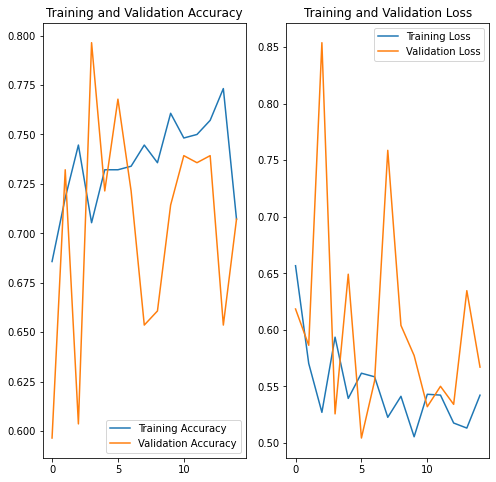

In [ ]:
acc = history.history['acc']
val_acc = history.history['val_acc']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(_epoch)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

##Prediction

Found 280 images belonging to 2 classes.


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


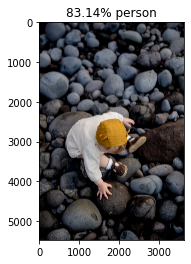

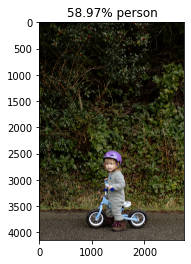

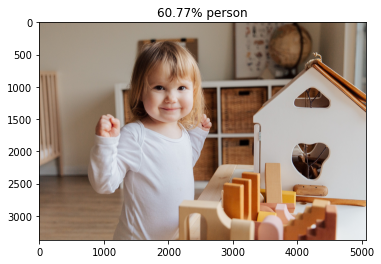

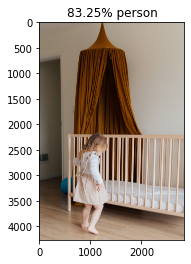

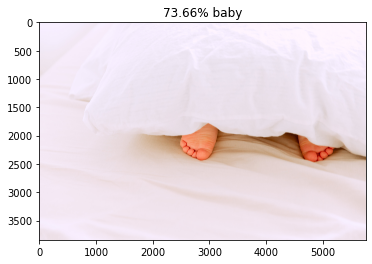

...

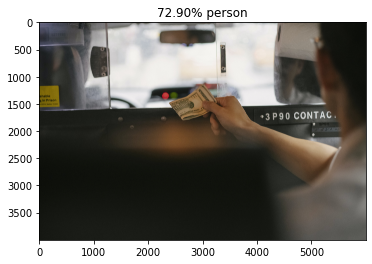

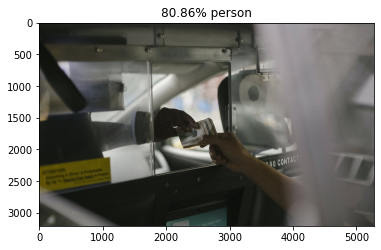

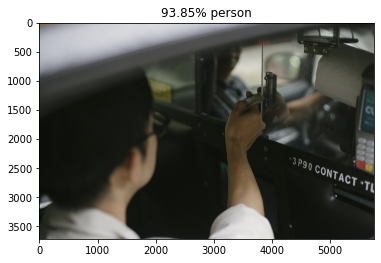

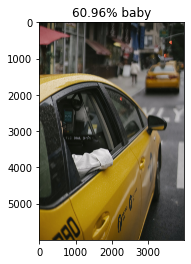

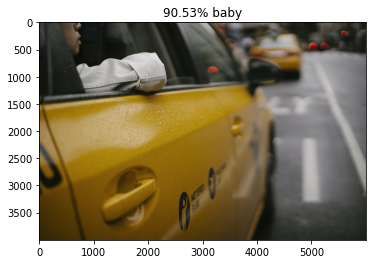

In [ ]:
test_data_generator = ImageDataGenerator(rescale=1./255)
test_generator = test_data_generator.flow_from_directory(
    validation_dir,
    target_size=(_img_size, _img_size),
    batch_size=1,
    class_mode="binary", 
    shuffle=False)

probabilities = model.predict_generator(test_generator)
for index, probability in enumerate(probabilities):
    image_path = validation_dir + "/" +test_generator.filenames[index]
    img = mpimg.imread(image_path)
    plt.imshow(img)
    if probability > 0.5:
        plt.title("%.2f" % (probability[0]*100) + "% person")
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% baby")
    plt.show()

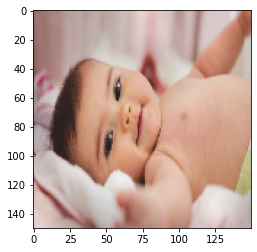

In [ ]:
a = model.predict(image)
predicted = tf.squeeze(a).numpy()
predicted_ids = np.argmax(predicted, axis=-1)
predicted_class_names = classes[predicted_ids]
plt.imshow(image[0])
print(predicted_class_names[10:])

##End

In [ ]:
os.kill(os.getpid(), signal.SIGKILL)